In [57]:
import json
with open('DynamoDBtoCSV-master/config.json') as f:
    Tuo_authentications = json.load(f)


In [59]:
import boto3

dynamodb_client = boto3.client('dynamodb',
                               aws_access_key_id = Tuo_authentications['accessKeyId'],
                               aws_secret_access_key = Tuo_authentications['secretAccessKey'],
                               region_name = Tuo_authentications["region"]
)
existing_tables = dynamodb_client.list_tables()
print(existing_tables)


{'TableNames': ['awseb-e-7d5pqhe4fb-stack-AWSEBWorkerCronLeaderRegistry-3CSA53KDCXWT', 'awseb-e-cm3tq3nyt5-stack-AWSEBWorkerCronLeaderRegistry-CEJKBWPGT3GH', 'awseb-e-zpnacgqw6v-stack-AWSEBWorkerCronLeaderRegistry-IVKF7204IKQ6', 'broadsign-reach-bid-request-log', 'hivestack-bid-request-log', 'location-audience-2019-03-08', 'location-audience-2019-05-20', 'location-audience-2019-08-09', 'location-audience-2019-08-17', 'open-rtb-bad-request', 'php-api', 'player-api', 'player-command', 'player-heartbeat', 'player-monitor', 'player-played-record', 'player-plays', 'player-status', 'player-unprocessed', 'plays', 'queue-device-play-requests', 'sync-locks', 'vast-request-log', 'viooh-bid-request-log', 'website-sessions', 'z-temp-plays'], 'ResponseMetadata': {'RequestId': '7NTUH3HURAESV7526EQTELNDLNVV4KQNSO5AEMVJF66Q9ASUAAJG', 'HTTPStatusCode': 200, 'HTTPHeaders': {'server': 'Server', 'date': 'Sun, 22 Sep 2019 20:55:52 GMT', 'content-type': 'application/x-amz-json-1.0', 'content-length': '713',

In [61]:
import boto3
from boto3.dynamodb.conditions import Key, Attr

dynamodb = boto3.resource('dynamodb',
                           aws_access_key_id = Tuo_authentications['accessKeyId'],
                           aws_secret_access_key = Tuo_authentications['secretAccessKey'],
                           region_name = Tuo_authentications["region"]
)


table = dynamodb.Table('location-audience-2019-08-17')

response = table.query(
    KeyConditionExpression=Key('locationHash').eq('eb54b7e048c7353be69954ea451d0276')
)
print(response)


{'Items': [{'uniqueDevicesAtLocation': Decimal('807'), 'count': Decimal('1'), 'dmaIndex': Decimal('0.7212974801777785'), 'locationHash': 'eb54b7e048c7353be69954ea451d0276', 'audienceSegmentId': Decimal('1'), 'entryType': 'LOCATION_SUMMARY', 'placeIqId': 'AutomotiveDealerships->Domestic->General->GMC->Buick', 'dmaName': '501'}, {'uniqueDevicesAtLocation': Decimal('807'), 'count': Decimal('2'), 'dmaIndex': Decimal('1.6279006665890747'), 'locationHash': 'eb54b7e048c7353be69954ea451d0276', 'audienceSegmentId': Decimal('2'), 'entryType': 'LOCATION_SUMMARY', 'placeIqId': 'AutomotiveDealerships->Domestic->Luxury->GMC->Cadillac', 'dmaName': '501'}, {'uniqueDevicesAtLocation': Decimal('807'), 'count': Decimal('23'), 'dmaIndex': Decimal('10'), 'locationHash': 'eb54b7e048c7353be69954ea451d0276', 'audienceSegmentId': Decimal('3'), 'entryType': 'LOCATION_SUMMARY', 'placeIqId': 'AutomotiveDealerships->Domestic->General->GMC->Chevrolet', 'dmaName': '501'}, {'uniqueDevicesAtLocation': Decimal('807'), 

In [39]:
import os

Tuo_working_directory = os.getcwd()

In [41]:
os.chdir(project_directory + "/DynamoDBtoCSV-master")
os.system("npm install")
table_name = "location-audience-2019-08-17"
os.system("node dynamoDBtoCSV.js -t " + table_name + " -f " + Tuo_working_directory + "/" + table_name + ".csv")  

2

In [42]:
os.chdir("../")

In [61]:
def audienceSegmentId_frequency(filename):
    f = open(filename)
    csv_data = csv.reader(f)
    audienceSegmentId_list = []
    audienceSegmentId_count = {}
    number = 0
    for row in csv_data:
        if number == 0:
            number += 1
            continue
        else:
            number += 1
        audienceSegmentId = row[4]
        audienceSegmentId_list.append(audienceSegmentId)
        if audienceSegmentId in audienceSegmentId_count:
            audienceSegmentId_count[audienceSegmentId] += 1
        else:
            audienceSegmentId_count[audienceSegmentId] = 1
    return audienceSegmentId_count

audienceSegmentId_count = audienceSegmentId_frequency(Tuo_working_directory + "/" + table_name + ".csv")
print(audienceSegmentId_count)

In [100]:
def audienceSegmentId_frequency(filename):
    f = open(filename)
    csv_data = csv.reader(f)
    
    audienceSegmentId_and_locationHash = {}
    number = 0
    for row in csv_data:
        if number == 0:
            number += 1
            continue
        else:
            number += 1
            
        count = row[1]
        locationHash = row[3]
        audienceSegmentId = row[4]
        if audienceSegmentId in audienceSegmentId_and_locationHash:
            locationHash_and_count = audienceSegmentId_and_locationHash[audienceSegmentId]
            if locationHash in locationHash_and_count:
                locationHash_and_count[locationHash] += count
            else:
                locationHash_and_count[locationHash] = count
        else:
            audienceSegmentId_and_locationHash[audienceSegmentId] = {locationHash: count}
    return audienceSegmentId_and_locationHash

audienceSegmentId_and_locationHash = audienceSegmentId_frequency(Tuo_working_directory + "/" + table_name + ".csv")
print(audienceSegmentId_and_locationHash)

{'1': {'b6e71c034fa5e34b5d8a9199208d53cb': '2', 'b14273d2a9fb0465d2fe6a1d859e5b6d': '93', 'f9fe2a60466142fc3666e5e20e4ca701': '4', '5a1308e5465bfe32d67b8171ec5a1a58': '34', 'fecaa6e724c8d218682f00e49328a173': '15', '4189a97e0a61cab5a19862910f6a555e': '225', 'b03a84f7ee3b2c4546e774cd36e762db': '60', '9a74a7e8192188f478b3bd3b1f887a03': '4'}, '2': {'b6e71c034fa5e34b5d8a9199208d53cb': '1', 'b14273d2a9fb0465d2fe6a1d859e5b6d': '45', 'f9fe2a60466142fc3666e5e20e4ca701': '1', '5a1308e5465bfe32d67b8171ec5a1a58': '30', 'fecaa6e724c8d218682f00e49328a173': '5', '4189a97e0a61cab5a19862910f6a555e': '235', 'b1b16e79fd5cad106899df827e3d9d12': '1', 'b03a84f7ee3b2c4546e774cd36e762db': '74', '9a74a7e8192188f478b3bd3b1f887a03': '4'}, '3': {'b6e71c034fa5e34b5d8a9199208d53cb': '5', 'b14273d2a9fb0465d2fe6a1d859e5b6d': '182', 'f9fe2a60466142fc3666e5e20e4ca701': '8', '3fa83a49e380c72cd6be15b29ac6e53d': '1', '5a1308e5465bfe32d67b8171ec5a1a58': '54', 'fecaa6e724c8d218682f00e49328a173': '29', '4189a97e0a61cab5a198

813


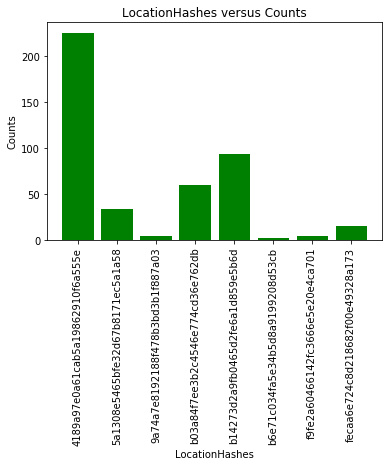

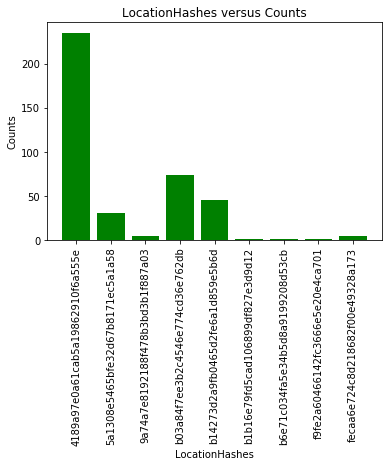

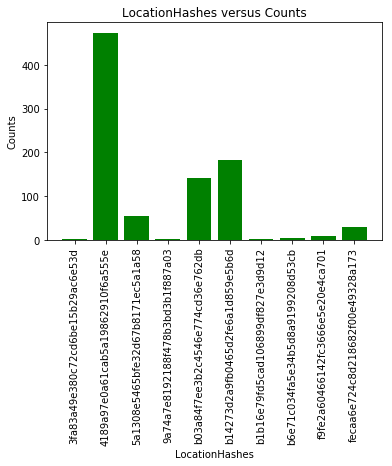

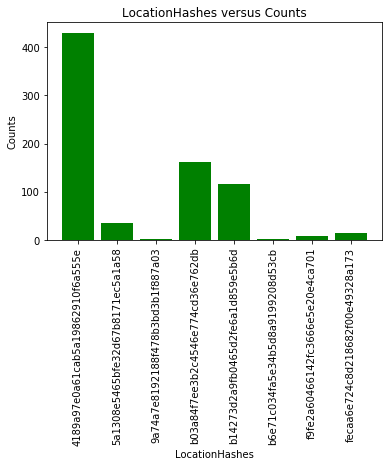

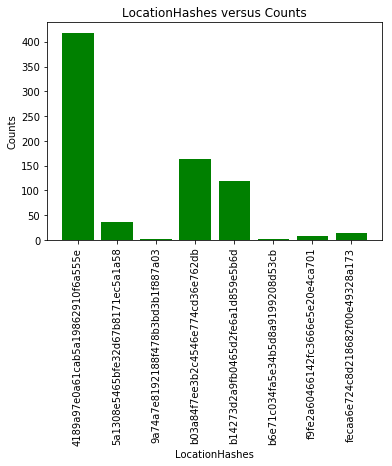

...

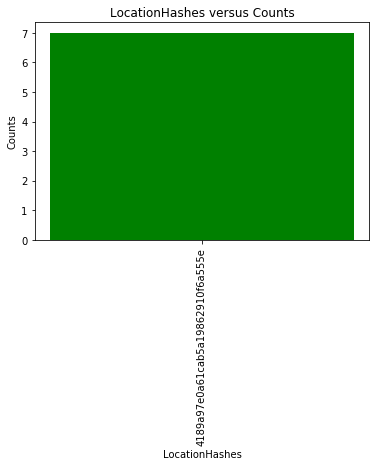

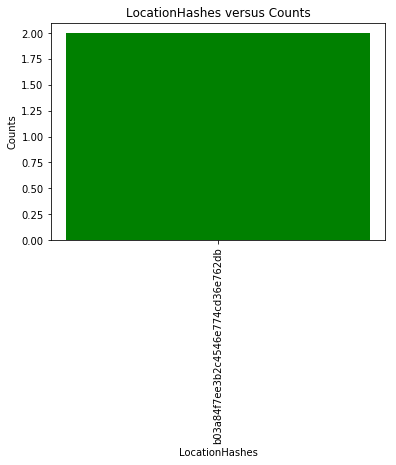

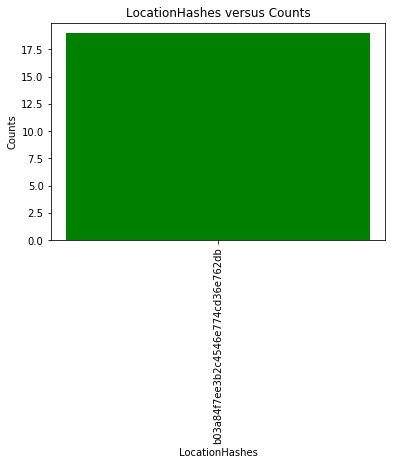

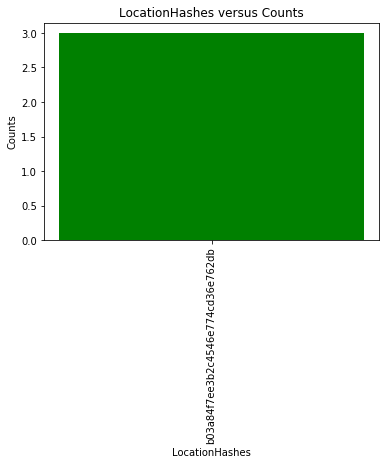

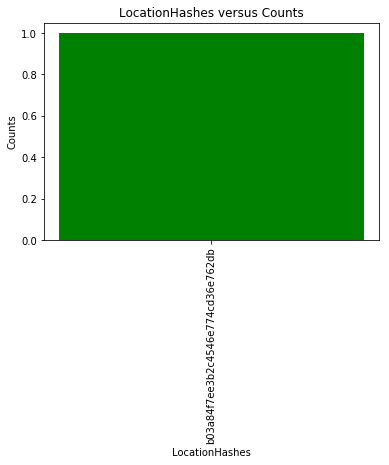

In [101]:
import matplotlib.pyplot as plt

def plot_for_each_audienceSegmentId(locationHash_and_count):
    
    locationHashes = locationHash_and_count.keys()
    counts = [int(count) for count in locationHash_and_count.values()]
    plt.bar(locationHashes, counts, color='g')
    plt.autoscale(enable=True, axis='x', tight=None)
    plt.xticks(rotation=90)
    plt.xlabel ('LocationHashes')
    plt.ylabel ('Counts')
    plt.title ('LocationHashes versus Counts')
    plt.show()
    
print(len(audienceSegmentId_and_locationHash.keys()))
for key in audienceSegmentId_and_locationHash.keys():
    plot_for_each_audienceSegmentId(audienceSegmentId_and_locationHash[key])